<a href="https://colab.research.google.com/github/Vinisenso/Vehicle_routing/blob/main/Trabalho_3_PO2_LE611.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

LE611 - Pesquisa Operacional II

Projeto 3 - Roteamento de Veículos

---


Integrantes do grupo:
- Augusto Chebel Machado (RA: 231762)
- João Pedro Marretto Helmeister (RA: 174564)
- Lucas Massabni Busnardo (RA: 182516)
- Lucas Tramonte (RA: 182697)
- Nathan Czelusniak de Siqueira (RA: 186041)
- Vinicius Consentino Muniz (RA: 245271)

---

##  Instalando e Importando Bibliotecas Importantes



In [ ]:
!pip install osmnx # Trabalha com a construção de malhas viárias.

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install haversine #trabalha com o cálculo de distância entre dois pontos no mapa.

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install k-means-constrained #trabalha com a construção de clusters entre os pontos do mapa.

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached k-means-constrained-0.7.2.tar.gz (2.6 MB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Using cached scipy-1.9.3-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (33.8 MB)
  Created wheel for k-means-constrained: filename=k_means_constrained-0.7.2-cp38-cp38-linux_x86_64.whl size=1521041 sha256=91fb02fb237d9e21cfde3110f4853e79e4191937d584798fdd1bd3f6ac6015fb
  Stored in directory: /root/.cache/pip/wheels/2b/1e/99/2a12e646c9e51ee2e2dae7885b7ccfadcc55779c6d207d93b1
Successfully built k-means-constrained
  Attempting uninstall: scipy
    Found existing installation: scipy 1.7.3
    Uninstalling scipy-1.7.3:
      Successfully uninstalled scipy-1.7.3


In [ ]:
!pip install ortools # trabalha com a solução de problemas de programação linerar

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd #trabalha com tratamento de tabelas. 

import matplotlib.pyplot as plt #trabalha com a plotagem de gráficos

import numpy as np #trabalha com a construção álgebra linear

from sklearn.cluster import KMeans # trabalha com a costrução de clusters

import seaborn as sns; sns.set() #trabalha com a coloração de tabelas

import random as rd #trabalha com número aleatórios

import osmnx as ox #trabalha com construção de malhas viárias e mapas

import folium

import os

from folium import plugins

import networkx as nx #trabalha com a definição do menor caminho entre dois pontos no mapa.

import haversine as hs #calula a distância entre dois pontos no mapa.

from ortools.constraint_solver import routing_enums_pb2 # resolve problemas de roteamento de veículos

from ortools.constraint_solver import pywrapcp

## Rede das ruas da cidade de Limeira 



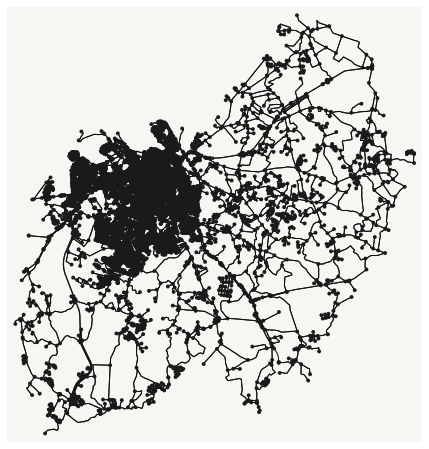

(<Figure size 576x576 with 1 Axes>, <AxesSubplot: >)

In [ ]:
G = ox.graph_from_place('Limeira, Brazil', network_type='drive')
ox.plot_graph(G,bgcolor="#f6f7f2", node_color="k", edge_color="#111111")

## Obtendo a geolocalização de clientes

In [ ]:
m = folium.Map(location=[-22.56777771962987, -47.40980179632528], zoom_start=10, tiles='CartoDB Dark_Matter', zoom_control=False, height="100%", tooltip = 'appear')    
folium.LayerControl().add_to(m)
plugins.Geocoder(position='topleft').add_to(m)


/usr/local/lib/python3.8/dist-packages/osmnx/utils.py:192: UserWarning: The `utils.config` function is deprecated and will be removed in a future release. Instead, use the `settings` module directly to configure a global setting's value. For example, `ox.settings.log_console=True`.
  warnings.warn(


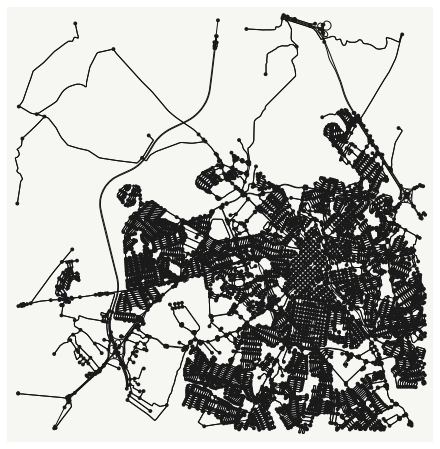

(<Figure size 576x576 with 1 Axes>, <AxesSubplot: >)

In [ ]:
ox.config(use_cache=True, log_console=True)
address = "FCA ,Limeira, Brazil"
mode = "drive"
G = ox.graph_from_address(address, dist=6000, simplify=True, network_type=mode)
ox.plot_graph(G, bgcolor="#f6f7f2", node_color="k", edge_color="#111111")

In [ ]:
graph_map = ox.plot_graph_folium(G, popup_atribute='name', edge_width=2)
graph_map

##Desenhando a rede de ruas: OSMnx -> Pandas -> Folium

In [ ]:
nodes, streets = ox.graph_to_gdfs(G)
streets

osmid  \
u           v           key                                                      
31939028    2148193075  0    [189242753, 1066933253, 189242759, 189242761, ...   
31940241    31939028    0                                              4908471   
            1858977657  0                                [78889169, 991346637]   
353459162   1824915598  0                                             78889163   
            6222134873  0                                            311496564   
...                                                                        ...   
10239515682 10239515697 0                 [1119513067, 1119513068, 1119513069]   
            2482807148  0                                           1119513067   
10239515697 2482807188  0                                            886968077   
            2482807242  0                                           1119513069   
            10239515682 0                 [1119513067, 1119513068, 1119513069]   

                             oneway      lanes     ref  \
u           v           key                              
31939028    2148193075  0      True  [2, 7, 3]  SP-348   
31940241    31939028    0      True          2  SP-348   
            1858977657  0      True     [2, 1]     NaN   
353459162   1824915598  0      True          1     NaN   
            6222134873  0      True          2  SP-151   
...                             ...        ...     ...   
10239515682 10239515697 0     False        NaN     NaN   
            2482807148  0     False        NaN     NaN   
10239515697 2482807188  0     False        NaN     NaN   
            2482807242  0     False        NaN     NaN   
            10239515682 0     False        NaN     NaN   

                                                                          name  \
u           v           key                                                      
31939028    2148193075  0    [Viaduto Palmiro Zorzo, Rodovia dos Bandeirantes]   
31940241    31939028    0                             Rodovia dos Bandeirantes   
            1858977657  0                        Trevo Doutor Arlindo de Salvo   
353459162   1824915598  0                                                  NaN   
            6222134873  0           Rodovia Doutor João Mendes da Silva Júnior   
...                                                                        ...   
10239515682 10239515697 0                                                  NaN   
            2482807148  0                                                  NaN   
10239515697 2482807188  0                               Rua Luís José Cavinato   
            2482807242  0                                                  NaN   
            10239515682 0                                                  NaN   

                                   highway                maxspeed reversed  \
u           v           key                                                   
31939028    2148193075  0         motorway  [100, 40, 80, 60, 120]    False   
31940241    31939028    0         motorway                     120    False   
            1858977657  0    motorway_link                     NaN    False   
353459162   1824915598  0    motorway_link                     NaN    False   
            6222134873  0          primary                      60    False   
...                                    ...                     ...      ...   
10239515682 10239515697 0      residential                     NaN    False   
            2482807148  0      residential                     NaN     True   
10239515697 2482807188  0      residential                     NaN     True   
            2482807242  0      residential                     NaN    False   
            10239515682 0      residential                     NaN     True   

                               length   bridge  \
u           v           key                      
31939028    2148193075  0    9221.574  viaduct   
319402

In [ ]:
nodes

,y,x,street_count,ref,highway,geometry
osmid,,,,,,
31939028,-22.575927,-47.458843,3,NaN,NaN,POINT (-47.45884 -22.57593)
31940241,-22.595027,-47.454508,3,155,motorway_junction,POINT (-47.45451 -22.59503)
32068072,-22.595859,-47.454760,3,NaN,NaN,POINT (-47.45476 -22.59586)
353459162,-22.567991,-47.441053,3,NaN,NaN,POINT (-47.44105 -22.56799)
353473836,-22.565717,-47.397395,3,NaN,NaN,POINT (-47.39740 -22.56572)
...,...,...,...,...,...,...
10239515656,-22.539721,-47.388893,3,NaN,NaN,POINT (-47.38889 -22.53972)
10239515661,-22.541170,-47.388599,3,NaN,NaN,POINT (-47.38860 -22.54117)
10239515663,-22.538991,-47.389717,3,NaN,NaN,POINT (-47.38972 -22.53899)


In [ ]:
style = {'color': '#F7DC6F', 'weight':'1'}
m = folium.Map([-22.56777771962987, -47.40980179632528], zoom_start=15, tiles="CartoDb dark_matter")
folium.GeoJson(streets, style_function=lambda x: style).add_to(m)
m.save("edges.html")
m

In [ ]:
# Escolhendo os pontos Aleatóriamente

FCA=2479551933
num_p= 15
num_r= []
l_p=[]

for i in range(0,num_p):
  num_r.append(rd.randint(0,len(nodes)))

for i in num_r:
  l_p.append(list(G)[i])
l_p.append(FCA)
# criando a base de dados para os pontos:
d_p=[]
for i in l_p:
  d_p.append(nodes.loc[i,:])


df=pd.DataFrame(d_p)

print(num_r)
print(l_p)

df


[5877, 3337, 4820, 1072, 4212, 5754, 5188, 1354, 5873, 3682, 4300, 3311, 2278, 5353, 5577]
[2482809885, 2479556686, 2481933879, 1696984739, 2480667542, 2482809455, 2482806709, 1953113759, 2482809869, 2480665100, 2481932189, 2479556432, 2479552134, 2482807460, 2482808750, 2479551933]


,y,x,street_count,ref,highway,geometry
2482809885,-22.584903,-47.379178,4,NaN,NaN,POINT (-47.3791776 -22.5849034)
2479556686,-22.577490,-47.450890,3,NaN,NaN,POINT (-47.4508902 -22.5774902)
2481933879,-22.598179,-47.406979,4,NaN,NaN,POINT (-47.4069792 -22.5981792)
1696984739,-22.583195,-47.406528,4,NaN,NaN,POINT (-47.4065281 -22.5831951)
2480667542,-22.600031,-47.389282,1,NaN,NaN,POINT (-47.3892821 -22.6000314)
2482809455,-22.578206,-47.371330,3,NaN,NaN,POINT (-47.3713303 -22.5782059)
2482806709,-22.534113,-47.391401,3,NaN,NaN,POINT (-47.3914006 -22.5341131)
1953113759,-22.550290,-47.408340,3,NaN,NaN,POINT (-47.4083398 -22.5502899)
2482809869,-22.584367,-47.378875,4,NaN,NaN,POINT (-47.3788754 -22.5843669)
2480665100,-22.558532,-47.392298,3,NaN,NaN,POINT (-47.3922977 -22.5585315)


## Encontrando o menor caminho

É possível calcular e traçar rotas de caminho mais curto entre pontos, levando em consideração as ruas de mão única.

In [ ]:
def distancia(origem, destino):
  D = []
  for o in range(len(origem)):
    aux = []
    for d in range(len(destino)):
      dist = nx.shortest_path(G,origem[o],destino[d])
      aux.append(dist)
    D.append(aux)
  return D

origem  = l_p
destino = l_p
D = distancia(origem, destino)
print(D)


[[[2482809885], [2482809885, 2482809928, 2482809949, 2482809951, 2482809994, 2482810015, 2482810012, 2480666899, 2480666913, 2480666915, 2480666910, 2480666845, 2480666830, 2480666796, 2480666789, 2480666677, 6970465858, 2480666667, 9159357266, 2480666664, 9159357265, 2480666633, 9159473448, 9159473449, 2480666619, 2480666603, 2480666559, 2480666544, 2480666542, 2480666528, 9165102436, 2480666493, 2480666485, 1696972678, 9165102437, 1696972725, 1696972660, 1696972617, 2480666109, 1696972686, 9165102441, 1697762022, 9165102439, 2479556059, 2479555748, 2479555240, 2479555080, 2479553961, 2479553790, 2479553513, 2479553531, 2479553541, 1449572534, 2479553906, 1449666303, 8411488059, 2479553970, 1449666308, 1824915512, 1824915541, 1824915560, 1824915598, 923665748, 1824915619, 1824915622, 2479556686], [2482809885, 2482809928, 2482809949, 2482809951, 2482809994, 2482810015, 2482810012, 2480666899, 2480666913, 2480666915, 2480666910, 2480666926, 2480666940, 2480667041, 2480667056, 5188951963

In [ ]:
dfd=pd.DataFrame(D)

dfd

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,[2482809885],"[2482809885, 2482809928, 2482809949, 248280995...","[2482809885, 2482809928, 2482809949, 248280995...","[2482809885, 2482809928, 2482809949, 248280995...","[2482809885, 2482809928, 2482809949, 248280995...","[2482809885, 2482809928, 8332781236, 248280990...","[2482809885, 2480666669, 2480666551, 248066643...","[2482809885, 2480666669, 2480666551, 248066643...","[2482809885, 2482809869]","[2482809885, 2480666669, 2480666551, 248066643...","[2482809885, 2482809928, 2482809949, 248280995...","[2482809885, 2482809928, 2482809949, 248280995...","[2482809885, 2482809928, 2482809949, 248280995...","[2482809885, 2480666669, 2480666551, 248066643...","[2482809885, 2482809869, 2482809840, 248280983...","[2482809885, 2482809928, 2482809949, 248280995..."
1,"[2479556686, 1858976781, 1858976969, 923665814...",[2479556686],"[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814...","[2479556686, 1858976781, 1858976969, 923665814..."
2,"[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366...",[2481933879],"[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933968, 8313688203, 248193401...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193377...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366...","[2481933879, 2481933876, 2481933801, 248193366..."
3,"[1696984739, 1693476674, 1696985268, 169348489...","[1696984739, 1696984733, 1972831656, 248066653...","[1696984739, 1696984733, 1972831656, 248066653...",[1696984739],"[1696984739, 2480666531, 2480666552, 193706226...","[1696984739, 1693476674, 1696985268, 169348489...","[1696984739, 1693476674, 1696985268, 169348489...","[1696984739, 1693476674, 1696985268, 169348489...","[1696984739, 1693476674, 1696985268, 169348489...","[1696984739, 1693476674, 1696985268, 169348489...","[1696984739, 2480666531, 2480666552, 193706226...","[1696984739, 1696984733, 1972831656, 248066653...","[1696984739, 1696984733, 1972831656, 248066653...","[1696984739, 1693476674, 1696985268, 169348489...","[1696984739, 1693476674, 1696985268, 169348489...","[1696984739, 1696984733, 1972831656, 248066653..."
4,"[2480667542, 2480667502, 2480667436, 248066742...","[2480667542, 2480667502, 2353805805, 235380577...","[2480667542, 2480667502, 2353805805, 235380580...","[2480667542, 2480667502, 2353805805, 235380577...",[2480667542],"[2480667542, 2480667502, 2353805805, 235380577...","[2480667542, 2480667502, 2480667436, 248066742...","[2480667542, 2480667502, 2480667436, 248066742...","[2480667542, 2480667502, 2480667436, 248066742...","[2480667542, 2480667502, 2480667436, 248066742...","[2480667542, 2480667502, 2353805805, 235380577...","[2480667542, 2480667502, 2353805805, 235380577...","[2480667542, 2480667502, 2353805805, 235380577...","[2480667542, 2480667502, 2480667436, 248066742...","[2480667542, 2480667502, 2480667436, 248066742...","[2480667542, 2480667502, 2353805805, 235380577..."
5,"[2482809

In [ ]:
def distancia(origem, destino):
  D = []
  for o in range(len(origem)):
    aux = []
    for d in range(len(destino)):
      dist = hs.haversine(origem.iloc[o,:],destino.iloc[d,:])
      aux.append(dist)
    D.append(aux)
  return D

origem  = df.loc[:,["y","x"]]
destino = df.loc[:,["y","x"]]
matrix = pd.DataFrame(distancia(origem, destino))
matrix

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,0.000000,7.408765,3.213342,2.814448,1.976297,1.097154,5.785423,4.876478,0.067242,3.227058,2.218451,4.901861,6.900246,4.127956,1.792049,6.369008
1,7.408765,0.000000,5.061199,4.598668,6.803515,8.169037,7.783552,5.313934,7.433241,6.374946,5.252996,2.561601,2.755637,7.876727,7.647986,3.276387
2,3.213342,5.061199,0.000000,1.666802,1.828370,4.281055,7.301223,5.326887,3.268540,4.659209,1.433072,3.127352,5.732470,6.191583,4.480171,5.508480
3,2.814448,4.598668,1.666802,0.000000,2.576733,3.656122,5.674442,3.663622,2.842050,3.107428,0.712074,2.143461,4.488570,4.713054,3.423795,4.126089
4,1.976297,6.803515,1.828370,2.576733,0.000000,3.047373,7.333018,5.866936,2.043366,4.624960,1.892669,4.606437,7.062418,5.863297,3.683153,6.696745
5,1.097154,8.169037,4.281055,3.656122,3.047373,0.000000,5.318475,4.906880,1.034128,3.069387,3.158891,5.615579,7.331960,3.527509,1.185098,6.732248
6,5.785423,7.783552,7.301223,5.674442,7.333018,5.318475,0.000000,2.502396,5.734083,2.716768,5.921403,5.874311,5.382971,1.848425,4.143267,4.677771
7,4.876478,5.313934,5.326887,3.663622,5.866936,4.906880,2.502396,0.000000,4.848836,1.885116,4.120439,3.402921,3.141244,2.797366,3.828255,2.413563
8,0.067242,7.433241,3.268540,2.842050,2.043366,1.034128,5.734083,4.848836,0.000000,3.186245,2.255349,4.920928,6.899716,4.070105,1.729124,6.363456
9,3.227058,6.374946,4.659209,3.107428,4.624960,3.069387,2.716768,1.885116,3.186245,0.000000,3.245471,3.977475,4.744873,1.645605,1.950724,4.053222


Text(0.5, 1.0, 'Matriz de distâncias')

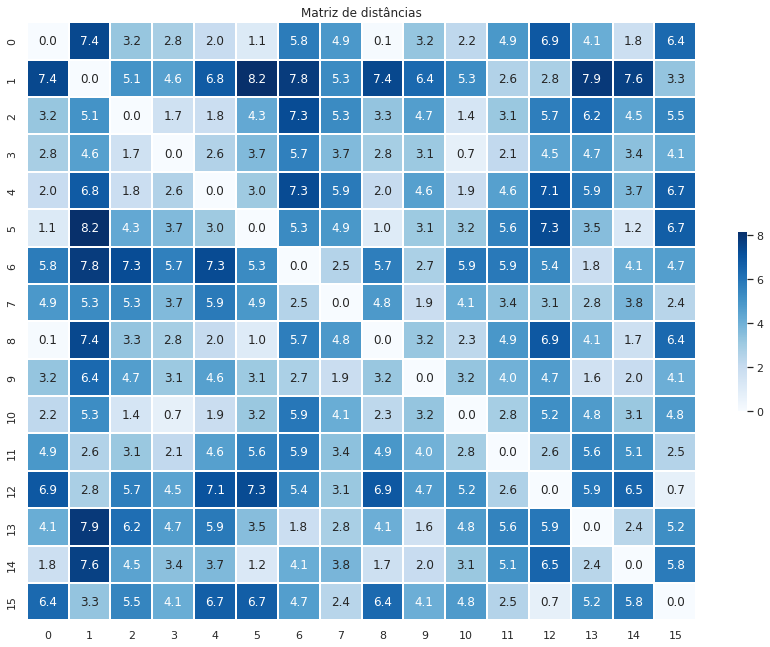

In [ ]:
#Plot da matriz de distâncias
import seaborn as sn
fig, ax = plt.subplots(figsize=(15, 11))
sn.heatmap(matrix, ax=ax, cmap='Blues', annot=True, fmt='.1f', cbar=True, cbar_kws={"shrink": .3}, linewidths=.1)
plt.title('Matriz de distâncias')

In [ ]:
df1=df.reset_index()
df1.drop(columns=['street_count',"ref",'highway','geometry'])


,index,y,x
0,2482809885,-22.584903,-47.379178
1,2479556686,-22.577490,-47.450890
2,2481933879,-22.598179,-47.406979
3,1696984739,-22.583195,-47.406528
4,2480667542,-22.600031,-47.389282
5,2482809455,-22.578206,-47.371330
6,2482806709,-22.534113,-47.391401
7,1953113759,-22.550290,-47.408340
8,2482809869,-22.584367,-47.378875
9,2480665100,-22.558532,-47.392298


In [ ]:
dfn=df1.loc[0:14,["index","x","y"]]
dfn

,index,x,y
0,2482809885,-47.379178,-22.584903
1,2479556686,-47.450890,-22.577490
2,2481933879,-47.406979,-22.598179
3,1696984739,-47.406528,-22.583195
4,2480667542,-47.389282,-22.600031
5,2482809455,-47.371330,-22.578206
6,2482806709,-47.391401,-22.534113
7,1953113759,-47.408340,-22.550290
8,2482809869,-47.378875,-22.584367
9,2480665100,-47.392298,-22.558532


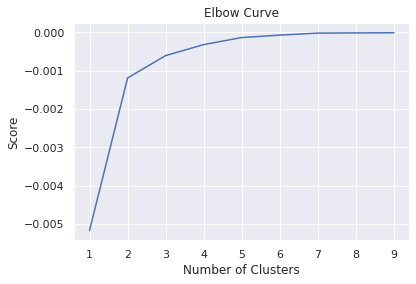

In [ ]:
K_clusters = range(1,10)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]
Y_axis = dfn[['y']]
X_axis = dfn[['x']]
score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

In [ ]:
from k_means_constrained import KMeansConstrained
kmeans = KMeansConstrained(
     n_clusters=3,
     size_min=0,
     size_max=5,
     random_state=0, init ='k-means++')
kmeans.fit(dfn[dfn.columns[1:3]]) # Compute k-means clustering.
dfn['cluster_label'] = kmeans.fit_predict(dfn[dfn.columns[1:3]])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(dfn[dfn.columns[1:3]]) # Labels of each point
dfn

dfn=dfn.sort_values(by='cluster_label')
dfn=dfn.reset_index()
dfn

,level_0,index,x,y,cluster_label
0,1,2479556686,-47.450890,-22.577490,0
1,2,2481933879,-47.406979,-22.598179,0
2,3,1696984739,-47.406528,-22.583195,0
3,11,2479556432,-47.425981,-22.576197,0
4,12,2479552134,-47.438392,-22.555560,0
5,0,2482809885,-47.379178,-22.584903,1
6,4,2480667542,-47.389282,-22.600031,1
7,5,2482809455,-47.371330,-22.578206,1
8,8,2482809869,-47.378875,-22.584367,1
9,10,2481932189,-47.400701,-22.586668,1


In [ ]:
fca=[]
fca.append(nodes.loc[FCA,:])
fca=pd.DataFrame(fca)

fca=fca.drop(columns=['street_count',"ref",'highway','geometry'])


In [ ]:
fca1=fca.reset_index()


In [ ]:
def distancia(origem, destino):
  D = []
  for o in range(len(origem)):
    aux = []
    for d in range(len(destino)):
      dist = hs.haversine(origem.iloc[o,:],destino.iloc[d,:])
      aux.append(dist)
    D.append(aux)
  return D




In [ ]:
dfc0=dfn.loc[0:4,["index",'x','y']]
dfc1=dfn.loc[5:9,["index",'x','y']]
dfc2=dfn.loc[10:14,["index",'x','y']]




In [ ]:
df01=pd.concat([fca1,dfc0],ignore_index=True)


origem  = df01[['y', 'x']]
destino = df01[['y', 'x']]
D1 = distancia(origem, destino)




In [ ]:
df02=pd.concat([fca1,dfc1],ignore_index=True)

origem  = df02[['y', 'x']]
destino = df02[['y', 'x']]
D2 = distancia(origem, destino)


In [ ]:
df03=pd.concat([fca1,dfc2],ignore_index=True)

origem  = df03[['y', 'x']]
destino = df03[['y', 'x']]
D3 = distancia(origem, destino)



In [ ]:
#Solução do problema atravé do Solver

#Fonte: https://developers.google.com/optimization/routing/tsp

def solve(d):
  def create_data_model():
      """Stores the data for the problem."""
      data = {}
      data['distance_matrix'] = d
          
      data['num_vehicles'] = 1
      data['depot'] = 0
      return data


  def print_solution(data, manager, routing, solution):
      """Prints solution on console."""
      max_route_distance = 0
      for vehicle_id in range(data['num_vehicles']):
          index = routing.Start(vehicle_id)
          plan_output = 'Route for vehicle {}:\n'.format(vehicle_id)
          route_distance = 0
          while not routing.IsEnd(index):
              plan_output += ' {} -> '.format(manager.IndexToNode(index))
              previous_index = index
              index = solution.Value(routing.NextVar(index))
              route_distance += routing.GetArcCostForVehicle(
                  previous_index, index, vehicle_id)
          plan_output += '{}\n'.format(manager.IndexToNode(index))
          plan_output += 'Distance of the route: {} km\n'.format(route_distance)
          print(plan_output)
          max_route_distance = max(route_distance, max_route_distance)
      



  def main():
      """Entry point of the program."""
      # Instantiate the data problem.
      data = create_data_model()

      # Create the routing index manager.
      manager = pywrapcp.RoutingIndexManager(len(data['distance_matrix']),
                                            data['num_vehicles'], data['depot'])

      # Create Routing Model.
      routing = pywrapcp.RoutingModel(manager)


      # Create and register a transit callback.
      def distance_callback(from_index, to_index):
          """Returns the distance between the two nodes."""
          # Convert from routing variable Index to distance matrix NodeIndex.
          from_node = manager.IndexToNode(from_index)
          to_node = manager.IndexToNode(to_index)
          return data['distance_matrix'][from_node][to_node]

      transit_callback_index = routing.RegisterTransitCallback(distance_callback)

      # Define cost of each arc.
      routing.SetArcCostEvaluatorOfAllVehicles(transit_callback_index)

      # Add Distance constraint.
      dimension_name = 'Distance'
      routing.AddDimension(
          transit_callback_index,
          0,  # no slack
          3000,  # vehicle maximum travel distance
          True,  # start cumul to zero
          dimension_name)
      distance_dimension = routing.GetDimensionOrDie(dimension_name)
      distance_dimension.SetGlobalSpanCostCoefficient(100)

      # Setting first solution heuristic.
      search_parameters = pywrapcp.DefaultRoutingSearchParameters()
      search_parameters.first_solution_strategy = (
          routing_enums_pb2.FirstSolutionStrategy.PATH_CHEAPEST_ARC)

      # Solve the problem.
      solution = routing.SolveWithParameters(search_parameters)

      # Print solution on console.
      if solution:
          print_solution(data, manager, routing, solution)
      else:
          print('No solution found !')


  if __name__ == '__main__':
      main()
  return 

In [ ]:
solve(D1)

Route for vehicle 0:
 0 ->  5 ->  1 ->  2 ->  3 ->  4 -> 0
Distance of the route: 12 km



In [ ]:
solve(D2)

Route for vehicle 0:
 0 ->  5 ->  2 ->  1 ->  4 ->  3 -> 0
Distance of the route: 13 km



In [ ]:
solve(D3)

Route for vehicle 0:
 0 ->  2 ->  3 ->  5 ->  4 ->  1 -> 0
Distance of the route: 11 km



## Criação de uma função que desenha as rotas no mapa.

In [ ]:
def esquema2(dfs,seqs,colors,n):
  import folium
  import networkx as nx
  a = list(dfs.loc[:,"index"])

  ordem=seqs
  
  routes = []
  count=0
  for i in range(0,6):
    origin = a[ordem[i]]
    destination = a[ordem[i+1]]
    routes.append(nx.shortest_path(G, origin, destination))

  for route in routes:
    nodes.loc[route,['y', 'x']]
    
    style = {'color': colors, 'weight':'3'}
    
    folium.GeoJson(streets.loc[route,:], style_function=lambda x: style,tooltip =f'Rota {n}'  ).add_to(m)

    origin_coords = list(nodes.loc[route[0],['y', 'x']])
    destination_coords = list(nodes.loc[route[-1],['y', 'x']])
    m.add_child(folium.CircleMarker(location=origin_coords, radius = 10.0, popup=str(count), color=colors, fill=True))
    m.add_child(folium.CircleMarker(location=destination_coords, radius = 10.0, popup='FCA (0)', color="black", fill=True))
    count+=1
  return 

In [ ]:
dfs=[df01,df02,df03]

seq1=[ 0 ,  5 ,  1 ,  2 ,  3 ,  4 , 0]
seq2= [0 ,5 ,  2 ,  1 ,  4 ,  3 , 0]
seq3= [0 ,2 ,  3 ,  5 ,  4 ,  1 , 0]
seqs=[seq1,seq2,seq3]

colors=['red','blue','yellow']
m = folium.Map([-22.6777771962987, -47.45980179632528], zoom_start=12, tiles="Stamen Toner")
esquema2(df01,seq1,"red","1")
esquema2(df02,seq2,"blue","2")
esquema2(df03,seq3,"green","3")
m